# Backpack price prediction challenge from kaggle

### Predict the price of backpack

In [41]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [42]:
df = pd.read_csv("test.csv")
pd.set_option("display.max_columns",None)
df.head()

,id,Brand,Material,Size,Compartments,Laptop Compartment,Waterproof,Style,Color,Weight Capacity (kg)
0,300000,Puma,Leather,Small,2.0,No,No,Tote,Green,20.671147
1,300001,Nike,Canvas,Medium,7.0,No,Yes,Backpack,Green,13.564105
2,300002,Adidas,Canvas,Large,9.0,No,Yes,Messenger,Blue,11.809799
3,300003,Adidas,Nylon,Large,1.0,Yes,No,Messenger,Green,18.477036
4,300004,NaN,Nylon,Large,2.0,Yes,Yes,Tote,Black,9.907953


In [43]:
print(f"Number of rows: {df.shape[0]}")
print(f"Number of columns : {df.shape[1]}")

Number of rows: 200000
Number of columns : 10


In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 10 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   id                    200000 non-null  int64  
 1   Brand                 193773 non-null  object 
 2   Material              194387 non-null  object 
 3   Size                  195619 non-null  object 
 4   Compartments          200000 non-null  float64
 5   Laptop Compartment    195038 non-null  object 
 6   Waterproof            195189 non-null  object 
 7   Style                 194847 non-null  object 
 8   Color                 193215 non-null  object 
 9   Weight Capacity (kg)  199923 non-null  float64
dtypes: float64(2), int64(1), object(7)
memory usage: 15.3+ MB


# Data Preprocessing



In [45]:
df.isnull().sum()

id                         0
Brand                   6227
Material                5613
Size                    4381
Compartments               0
Laptop Compartment      4962
Waterproof              4811
Style                   5153
Color                   6785
Weight Capacity (kg)      77
dtype: int64

#### Handling missing values of brand

In [46]:
df['Brand'].value_counts()

Brand
Adidas          40173
Under Armour    40139
Nike            38273
Puma            37857
Jansport        37331
Name: count, dtype: int64

In [47]:
print("Checking whether brand is related with material")
pd.crosstab(df['Material'], df['Brand'])

Checking whether brand is related with material


Brand,Adidas,Jansport,Nike,Puma,Under Armour
Material,,,,,
Canvas,9162,8228,8749,8361,9022
Leather,9796,9209,9438,9145,9770
Nylon,9312,9153,8907,9141,9542
Polyester,10778,9751,10134,10122,10656


In [48]:
print("Checking whether brand is related with Color")
pd.crosstab(df['Color'],df['Brand'])

Checking whether brand is related with Color


Brand,Adidas,Jansport,Nike,Puma,Under Armour
Color,,,,,
Black,6278,5899,5872,5836,6157
Blue,6340,5938,6134,6078,6513
Gray,6558,6126,6503,6241,6799
Green,6305,5843,5885,5794,6006
Pink,7011,6467,6507,6686,7002
Red,6358,5818,6080,5919,6281


In [49]:
print("Checking whether brand is related with compartments")
df.groupby("Brand")["Compartments"].mean()

Checking whether brand is related with compartments


Brand
Adidas          5.429019
Jansport        5.408106
Nike            5.500144
Puma            5.451356
Under Armour    5.429258
Name: Compartments, dtype: float64

In [50]:
print("Cheking whether brand is related with laptop compartment")
pd.crosstab(df['Brand'],df['Laptop Compartment'])

Cheking whether brand is related with laptop compartment


Laptop Compartment,No,Yes
Brand,,
Adidas,19299,19875
Jansport,17971,18451
Nike,18482,18846
Puma,18379,18542
Under Armour,19215,19930


In [51]:
print("Checking whether brand is related with weight Capacity (kg)")
df.groupby("Brand")["Weight Capacity (kg)"].mean()

Checking whether brand is related with weight Capacity (kg)


Brand
Adidas          17.963205
Jansport        17.991790
Nike            18.059937
Puma            17.896119
Under Armour    18.086548
Name: Weight Capacity (kg), dtype: float64

In [52]:
print("Checking whether brand is related with water proof")
pd.crosstab(df['Brand'],df['Waterproof'])

Checking whether brand is related with water proof


Waterproof,No,Yes
Brand,,
Adidas,19284,19868
Jansport,18129,18267
Nike,18372,19005
Puma,18437,18495
Under Armour,19277,19891


In [53]:
print("Checking whether brand is related with color")
pd.crosstab(df['Brand'],df['Color'])

Checking whether brand is related with color


Color,Black,Blue,Gray,Green,Pink,Red
Brand,,,,,,
Adidas,6278,6340,6558,6305,7011,6358
Jansport,5899,5938,6126,5843,6467,5818
Nike,5872,6134,6503,5885,6507,6080
Puma,5836,6078,6241,5794,6686,5919
Under Armour,6157,6513,6799,6006,7002,6281


Since no other feature is related with the brand we proportional imputation - to avoid disproportion of brand

In [54]:
brand_distribution = df['Brand'].value_counts(normalize=True)
brand_distribution

Brand
Adidas          0.207320
Under Armour    0.207144
Nike            0.197515
Puma            0.195368
Jansport        0.192653
Name: proportion, dtype: float64

In [55]:
missing_brand_indices = df[df['Brand'].isnull()].index
df.loc[missing_brand_indices,"Brand"] = np.random.choice(brand_distribution.index,size=len(missing_brand_indices),p=brand_distribution.values)

In [56]:
df['Brand'].value_counts(normalize=True) # this shows we almost normalized the bias 

Brand
Adidas          0.207615
Under Armour    0.206935
Nike            0.197635
Puma            0.195290
Jansport        0.192525
Name: proportion, dtype: float64

#### Handling missing values of feature - material

We do proportional imputation 


In [57]:
material_distribution = df['Material'].value_counts(normalize=True)
material_distribution

Material
Polyester    0.272791
Leather      0.252018
Nylon        0.244322
Canvas       0.230869
Name: proportion, dtype: float64

In [58]:
missing_material_indices = df[df['Material'].isnull()].index
df.loc[missing_material_indices,'Material'] = np.random.choice(material_distribution.index,size=len(missing_material_indices),p=material_distribution.values)

#### Handling missing values of size
We do proportion imputation

In [59]:
missing_size = df['Size'].value_counts(normalize=True)
missing_size_indices  = df[df['Size'].isnull()].index
df.loc[missing_size_indices,'Size'] = np.random.choice(missing_size.index,size = len(missing_size_indices),p = missing_size.values)


In [60]:
df.isnull().sum()

id                         0
Brand                      0
Material                   0
Size                       0
Compartments               0
Laptop Compartment      4962
Waterproof              4811
Style                   5153
Color                   6785
Weight Capacity (kg)      77
dtype: int64

#### Handling missing values of Laptop compartments

In [61]:
missing_laptop_compartment = df['Laptop Compartment'].value_counts(normalize=True)
missing_laptop_compartment_indices  = df[df['Laptop Compartment'].isnull()].index
df.loc[missing_laptop_compartment_indices,'Laptop Compartment'] = np.random.choice(missing_laptop_compartment.index,
                                                                                   size = len(missing_laptop_compartment_indices),
                                                                                   p = missing_laptop_compartment.values)

#### Handling missing values of Waterproof

In [62]:
missing_waterproof = df['Waterproof'].value_counts(normalize=True)
missing_waterproof_indices  = df[df['Waterproof'].isnull()].index
df.loc[missing_waterproof_indices,'Waterproof'] = np.random.choice(missing_waterproof.index,
                                                                                   size = len(missing_waterproof_indices),
                                                                                   p = missing_waterproof.values)

#### Handling missing values of Style

In [63]:
df["Style"].fillna(df["Style"].mode()[0], inplace=True)

C:\Users\USER\AppData\Local\Temp\ipykernel_7664\1596473975.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





#### Handling missing values of Color

In [64]:
df['Color'].fillna(df['Color'].mode()[0],inplace=True)

C:\Users\USER\AppData\Local\Temp\ipykernel_7664\1859550221.py:1: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





#### Handling missing values of weight capacity

In [65]:
df.fillna({'Weight Capacity (kg)':df['Weight Capacity (kg)'].mean()},inplace=True)

In [66]:
df.isnull().sum()

id                      0
Brand                   0
Material                0
Size                    0
Compartments            0
Laptop Compartment      0
Waterproof              0
Style                   0
Color                   0
Weight Capacity (kg)    0
dtype: int64

Checking for outliers

In [67]:
sns.boxplot(df['Price'])
plt.show()

KeyError: 'Price'

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


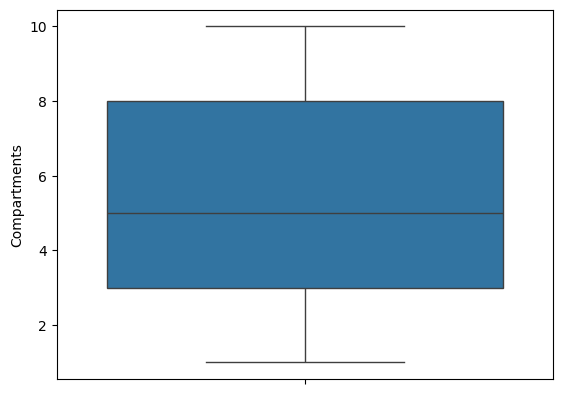

In [ ]:
sns.boxplot(df['Compartments'])
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning: SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.
  positions = grouped.grouper.result_index.to_numpy(dtype=float)


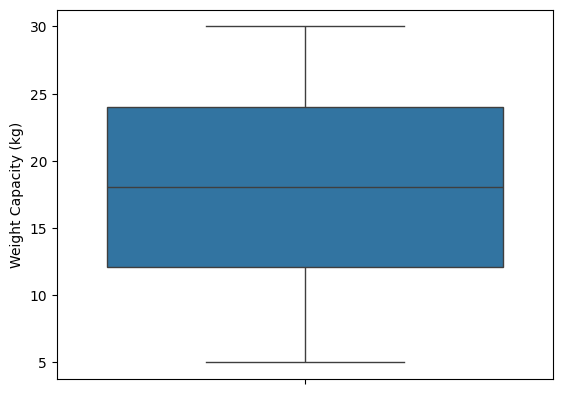

In [ ]:
sns.boxplot(df['Weight Capacity (kg)'])
plt.show()

## Exploratory Data Analysis

### Univariate Analysis

#### 1. Categorical

In [ ]:
numeric = df.select_dtypes(include='number').columns.tolist()[1:]
categorical = df.select_dtypes(include='object').columns.tolist()
print("Numerical columns : ",numeric)
print("categorical columns :",categorical)

Numerical columns :  ['Compartments', 'Weight Capacity (kg)']
categorical columns : ['Brand', 'Material', 'Size', 'Laptop Compartment', 'Waterproof', 'Style', 'Color']


In [ ]:
def univ_cat(df, col):
    fig = make_subplots(rows=1, cols=2, specs=[[{'type':'histogram'}, {'type':'pie'}]], subplot_titles=['Histogram', 'Pie'])
    fig.add_trace(go.Histogram(x=df[col]), 1, 1)
    fig.add_trace(go.Pie(labels=df[col].value_counts().index, values=df[col].value_counts(), textinfo='label+percent'), 1, 2)
    fig.update_layout( title_text=f'{col}')
    fig.update_traces(showlegend=False)
    fig.show()

In [ ]:
for column in categorical:
    univ_cat(df,column)

#### 2. Numerical 

In [ ]:
print(df[numeric].describe())

        Compartments  Weight Capacity (kg)
count  200000.000000         200000.000000
mean        5.442855             17.993033
std         2.888740              6.970737
min         1.000000              5.000000
25%         3.000000             12.069734
50%         5.000000             18.051533
75%         8.000000             23.965658
max        10.000000             30.000000


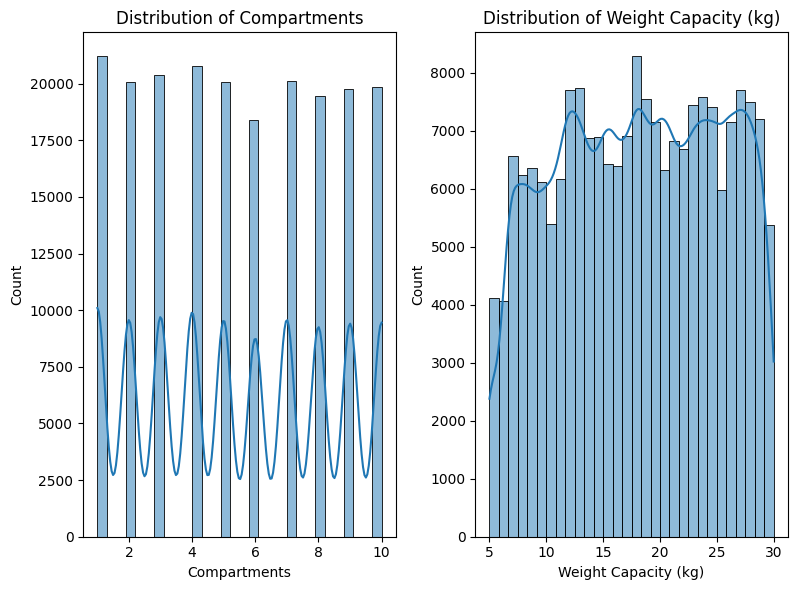

In [ ]:
plt.figure(figsize=(12, 6))
for i, col in enumerate(numeric, 1):
    plt.subplot(1, 3, i)
    sns.histplot(df[col], kde=True, bins=30)
    plt.title(f"Distribution of {col}")
plt.tight_layout()
plt.show()


This shows 
1. compartments are discrete
2. Weight Capacity and Price are Uniformly distributed 

### Bivariate Analysis

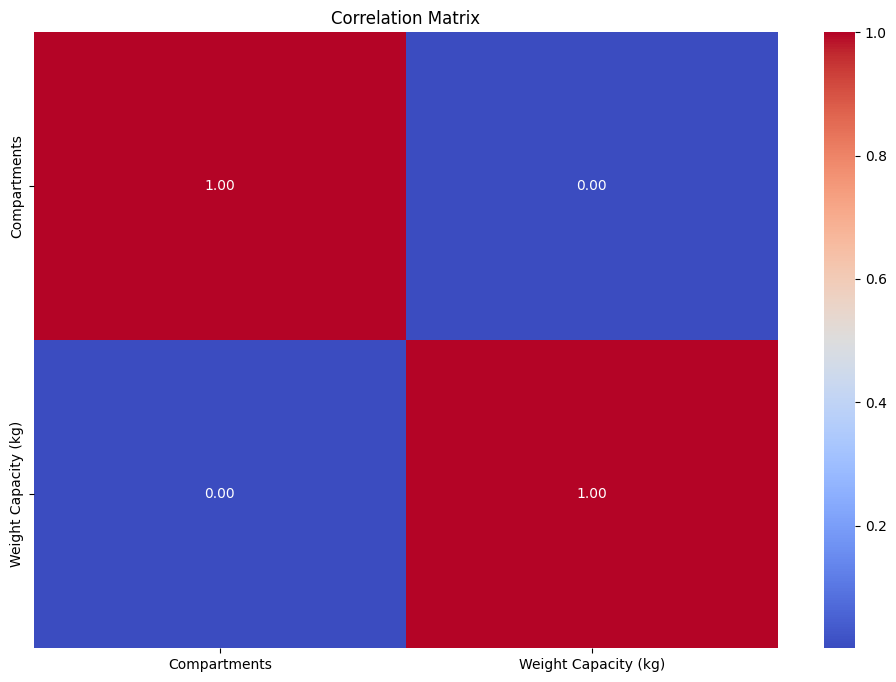

In [ ]:
correlation_matrix = df[numeric].corr()
plt.figure(figsize=(12,8))

sns.heatmap(correlation_matrix,annot = True, fmt = '.2f',cmap = 'coolwarm')
plt.title("Correlation Matrix")
plt.show()

This shows weak or no relationship as all correlation values is  < 0.2 

KeyError: 'Price'

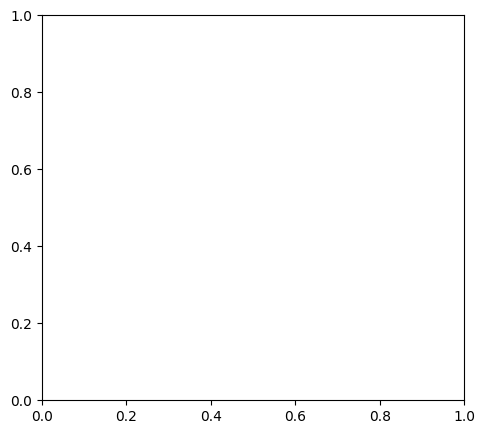

In [ ]:
plt.figure(figsize=(12, 5))
for i, col in enumerate(numeric[:-1], 1):
    plt.subplot(1, 2, i)
    sns.scatterplot(x=df[col], y=df["Price"])
    plt.title(f"Price vs {col}")
plt.tight_layout()
plt.show()

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



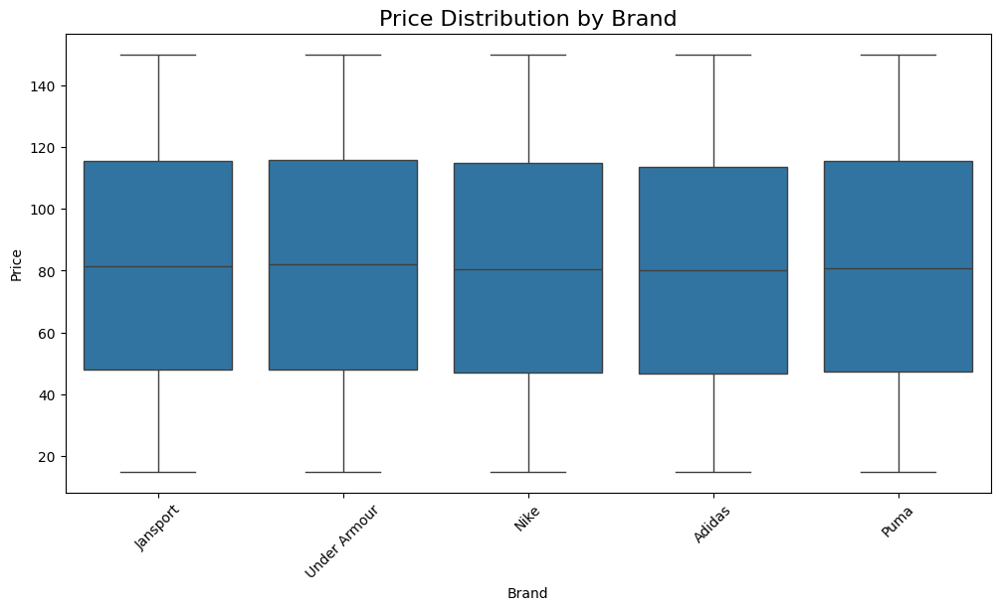

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



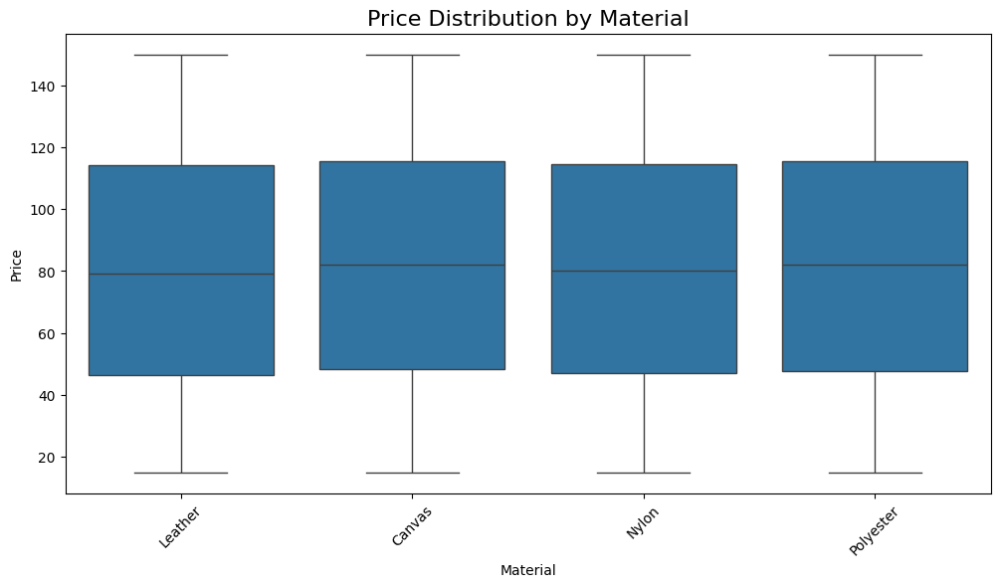

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



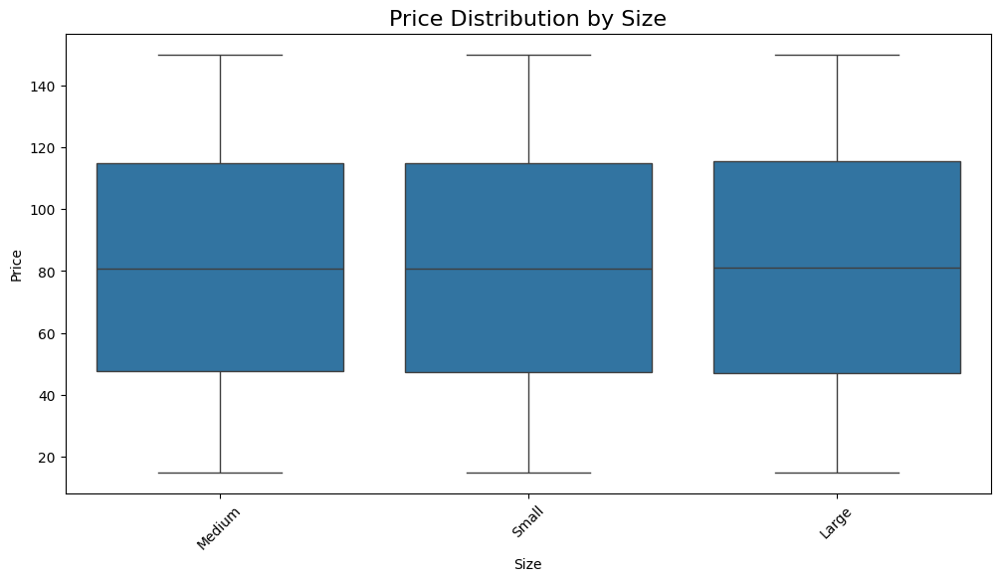

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



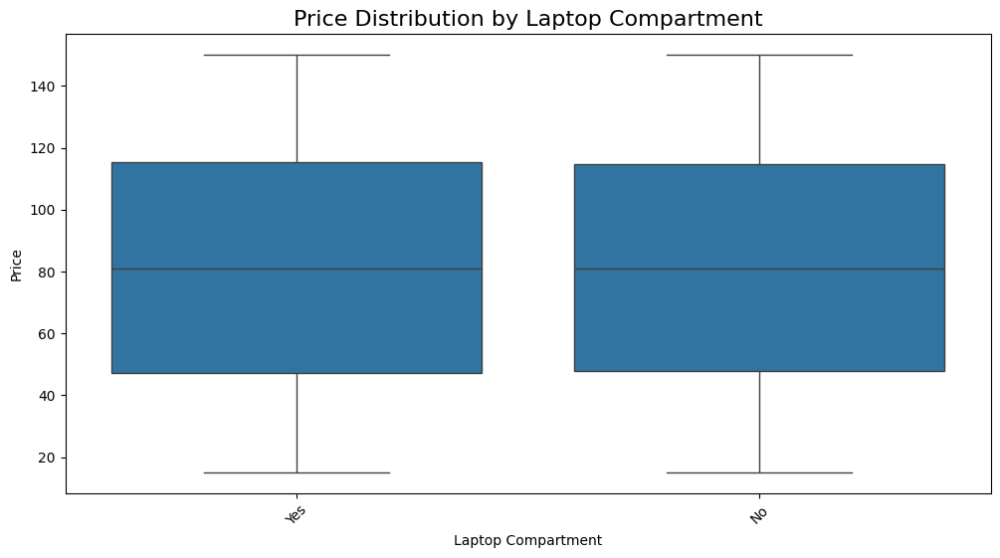

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



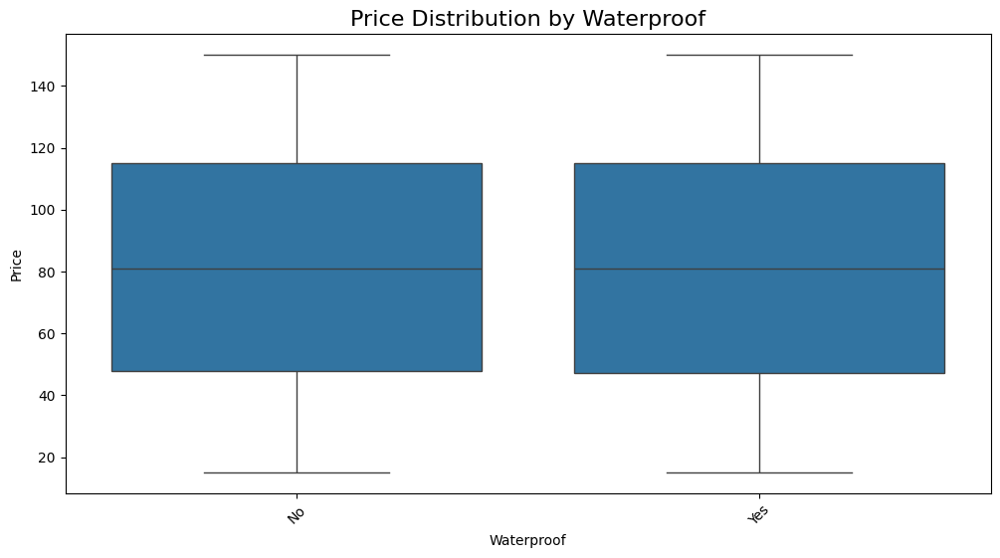

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



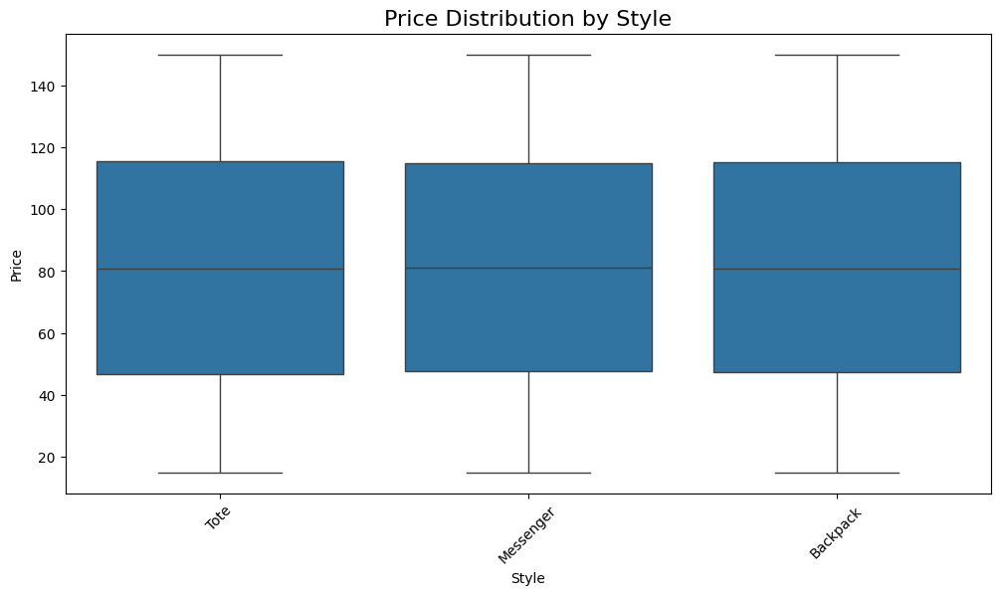

c:\Users\USER\AppData\Local\Programs\Python\Python311\Lib\site-packages\seaborn\categorical.py:632: FutureWarning:

SeriesGroupBy.grouper is deprecated and will be removed in a future version of pandas.



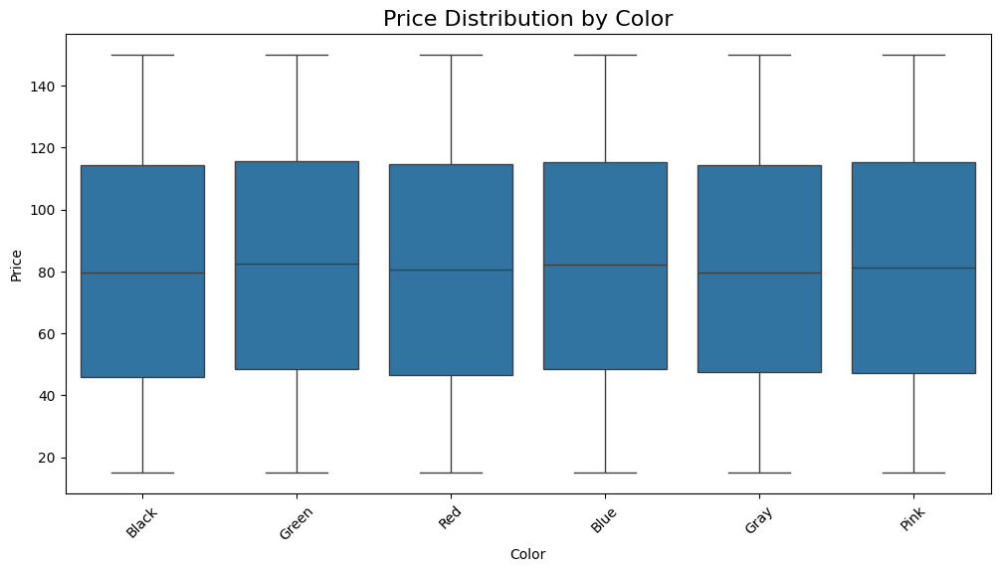

In [ ]:
for col in categorical:
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=df, x=col, y='Price', hue=None)  
    plt.title(f'Price Distribution by {col}', fontsize=16)
    plt.xticks(rotation=45)
    plt.show()


In [ ]:

for col in categorical:
    group_stats = df.groupby(col)['Price'].agg(['mean', 'median', 'std']).sort_values(by='mean', ascending=False)
    print(f"\nStatistics for {col}:\n", group_stats)



Statistics for Brand:
                    mean     median        std
Brand                                        
Under Armour  81.990752  82.059110  38.994420
Jansport      81.752921  81.414820  39.004732
Puma          81.412154  80.609920  39.237062
Nike          81.254796  80.513715  39.134668
Adidas        80.661394  80.116840  38.825539

Statistics for Material:
                 mean    median        std
Material                                 
Canvas     82.108399  82.11457  39.012290
Polyester  82.028859  81.95113  39.087272
Nylon      81.040998  80.27355  38.899106
Leather    80.450108  79.24951  39.122896

Statistics for Size:
              mean     median        std
Size                                   
Large   81.583400  81.176790  39.347737
Small   81.358351  80.793025  39.025750
Medium  81.292509  80.863720  38.750997



Statistics for Laptop Compartment:
                          mean    median        std
Laptop Compartment                                
No                  81.423647  80.80867  38.847653
Yes                 81.398911  81.08455  39.224987

Statistics for Waterproof:
                  mean    median        std
Waterproof                                
No          81.490036  80.96864  38.870581
Yes         81.333951  80.91726  39.203581

Statistics for Style:
                 mean    median        std
Style                                    
Messenger  81.451328  81.20564  38.886298
Backpack   81.402513  80.84331  39.039632
Tote       81.374865  80.75943  39.208353

Statistics for Color:
             mean    median        std
Color                                
Green  82.381308  82.49228  38.934312
Blue   82.006994  82.30756  38.833774
Pink   81.653538  81.13414  39.141575
Red    81.011644  80.72338  39.391864
Gray   80.851971  79.78348  38.682311
Black  80.513439  79.51800  39.212

#### Inferences from statistics:
1. Under Armour brand has highest mean - 81.922844.There is price consistency among the brands
2. Canvas and polyester has high mean prices. Leather’s lower mean and high standard deviation could indicate a wider variety in quality and pricing tiers. 
3. The mean price is proportional to size 
4. Laptop compartment might be standard in most bags since there isn't much mean price difference. 
5. Bags without waterproof might have styles and designs
6. Messenger styled bags have higher mean.
7. Green,Blue bags have high mean prices - could be professional
8. Red has high std deviation so it might have high vareity and designs with wider price range 
9. Gray and Black has lower mean. 

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




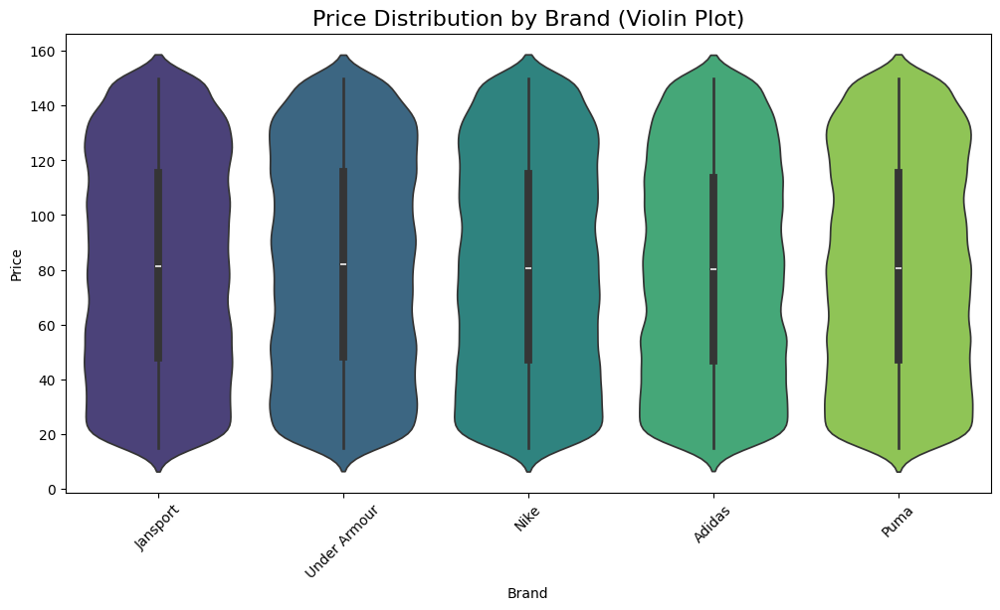

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




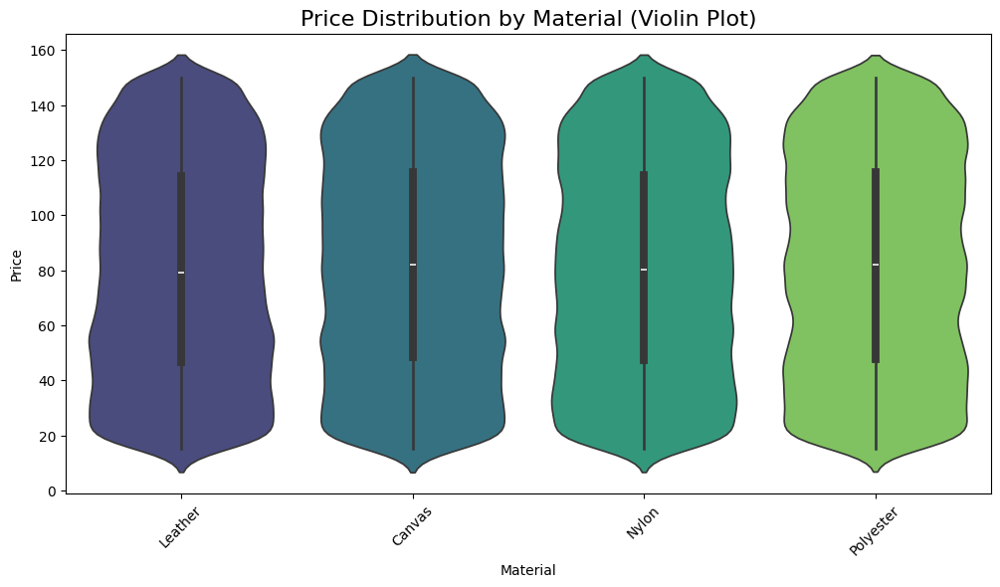

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




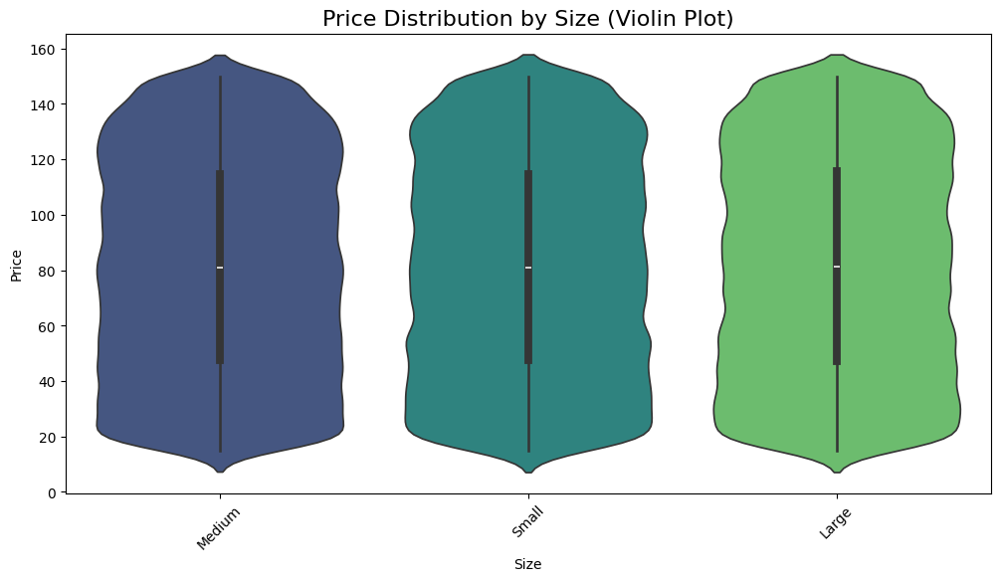

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




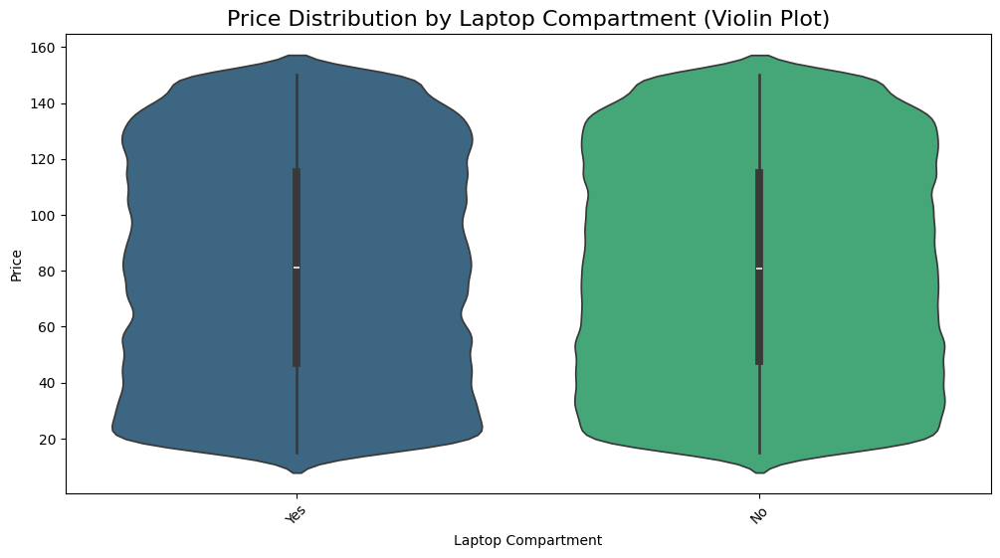

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




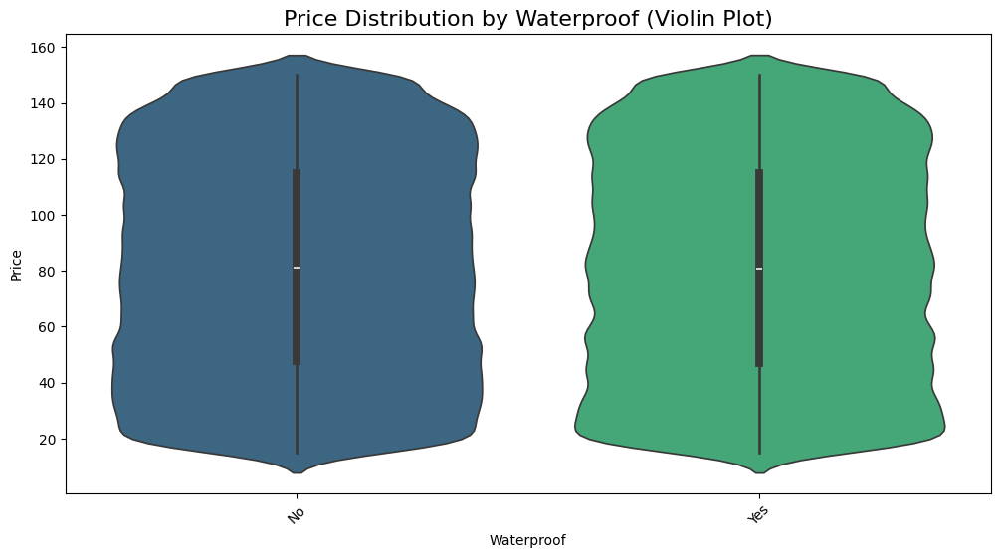

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




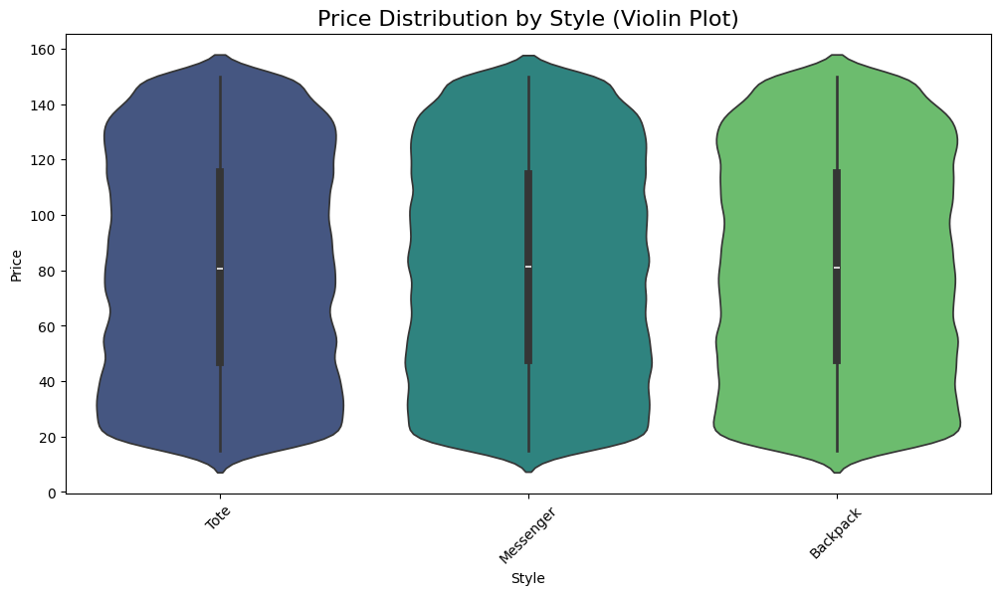

C:\Users\USER\AppData\Local\Temp\ipykernel_3096\557288870.py:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




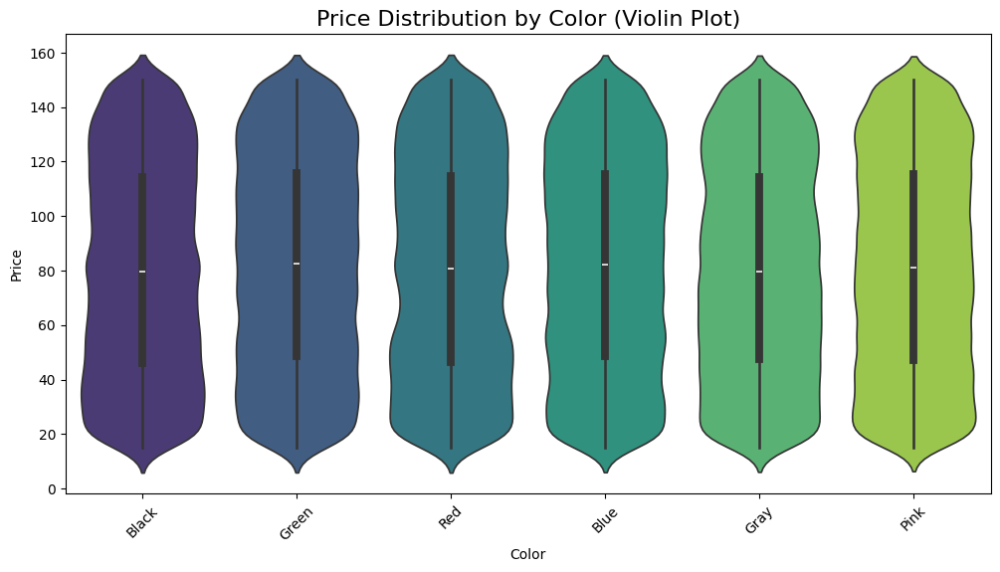

In [ ]:

for col in categorical:
    plt.figure(figsize=(12, 6))
    sns.violinplot(data=df, x=col, y='Price', palette='viridis',hue = None)
    plt.title(f'Price Distribution by {col} (Violin Plot)', fontsize=16)
    plt.xticks(rotation=45)
    plt.show()


## Feature Engineering

In [ ]:
df['Price_to_compartment'] = df['Price']/df['Compartments']

In [ ]:
df['weight_to_compartment'] = df['Weight Capacity (kg)'] / df['Compartments']

In [ ]:
df['Price'].describe()

count    300000.000000
mean         81.411107
std          39.039340
min          15.000000
25%          47.384620
50%          80.956120
75%         115.018160
max         150.000000
Name: Price, dtype: float64

Using quantile binning for Price

In [ ]:
df['Price_bin'] = pd.qcut(df['Price'], q=5, labels=False)
df['Price_bin'].value_counts().sort_index()

Price_bin
0    60003
1    59998
2    60001
3    60005
4    59993
Name: count, dtype: int64

In [ ]:
print(df['Weight Capacity (kg)'].describe())

count    200000.000000
mean         17.993033
std           6.970737
min           5.000000
25%          12.069734
50%          18.051533
75%          23.965658
max          30.000000
Name: Weight Capacity (kg), dtype: float64


Using quantile binning for Weight capacity

In [ ]:
df['weight_bin'] = pd.qcut(df['Weight Capacity (kg)'], q=5, labels=False)
print(df['weight_bin'].value_counts().sort_index()) 

weight_bin
0    40001
1    39999
2    40016
3    39987
4    39997
Name: count, dtype: int64


In [ ]:

weight_price_stats = df.groupby('weight_bin')['Price'].agg(['mean', 'median', 'std', 'count'])
print(weight_price_stats)


                 mean     median        std  count
weight_bin                                        
0           79.691273  78.286690  38.804411  60000
1           81.402033  80.239520  39.472656  60000
2           82.407696  82.842560  39.006042  60000
3           81.701418  81.971070  39.009820  60000
4           81.853114  81.527325  38.847278  60000


In [ ]:
df['Price_per_kg'] = df['Price'] / df['Weight Capacity (kg)']

In [ ]:
df = pd.get_dummies(df, columns=['Brand', 'Material', 'Style', 'Color','Waterproof','Laptop Compartment'], drop_first=True)

In [ ]:
size_mapping = {'Small': 0, 'Medium': 1, 'Large': 2}
df['Size'] = df['Size'].map(size_mapping)


In [ ]:
df.columns

Index(['id', 'Size', 'Compartments', 'Weight Capacity (kg)',
       'weight_to_compartment', 'weight_bin', 'Brand_Jansport', 'Brand_Nike',
       'Brand_Puma', 'Brand_Under Armour', 'Material_Leather',
       'Material_Nylon', 'Material_Polyester', 'Style_Messenger', 'Style_Tote',
       'Color_Blue', 'Color_Gray', 'Color_Green', 'Color_Pink', 'Color_Red',
       'Waterproof_Yes', 'Laptop Compartment_Yes'],
      dtype='object')

In [ ]:
scaler = StandardScaler()  # or MinMaxScaler()
df[[ 'Weight Capacity (kg)', 'Compartments','weight_to_compartment']] = scaler.fit_transform(
    df[['Weight Capacity (kg)', 'Compartments','weight_to_compartment']])

In [ ]:
df.to_csv("cleaned_test.csv", index=False)

In [ ]:
df_copy = df.drop(columns=['id'])

Splitting the dataset

In [ ]:
X = df_copy.drop(columns=['Price'])
y = df_copy['Price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Model Training -  Linear Regression

In [ ]:
model_LinearRegression = LinearRegression()
model_LinearRegression.fit(X_train,y_train)

LinearRegression()

In [ ]:
y_pred = model_LinearRegression.predict(X_test)

In [ ]:
len(y_pred)
len(y_test)

NameError: name 'y_pred' is not defined

In [ ]:
print("MAE:", mean_absolute_error(y_test, y_pred))
print("MSE:", mean_squared_error(y_test, y_pred))
print("R² Score:", r2_score(y_test, y_pred))
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("RMSE:", rmse)

MAE: 0.16184289873865554
MSE: 0.03658141511250886
R² Score: 0.963238910261188
RMSE: 0.19126268614789677
